In [ ]:
# do not run when we import this package as module
if __name__ == '__main__':
  # Connect Google Drive
  from google.colab import drive
  drive.mount('/content/gdrive/', force_remount=True)

Mounted at /content/gdrive/


In [ ]:
# Common
import os
import numpy as np
import pandas as pd
import tensorflow as tf
from IPython.display import clear_output as cls
import datetime

# Data
from tqdm import tqdm
from glob import glob
import tensorflow.data as tfd

# Data Visualization
import plotly.express as px
import matplotlib.pyplot as plt

# Model
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras import callbacks
from tensorflow.keras import applications as tka

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
# Clear any logs from previous runs
!rm -rf /content/gdrive/MyDrive/OWR/log/OCR_Model2/

In [ ]:
!pip install keras_tuner
import keras_tuner as kt
cls()

In [ ]:
!pip install opendatasets
cls()

In [ ]:
import opendatasets as od

# Specify the Kaggle dataset URL
dataset_url = "https://www.kaggle.com/datasets/preatcher/standard-ocr-dataset"

# Download the dataset to the specified folder
od.download(dataset_url)

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: sachithgunawardane
Your Kaggle Key: ··········


100%|██████████| 46.2M/46.2M [00:02<00:00, 17.7MB/s]


In [ ]:
# The batch size
BATCH_SIZE = 64

# Image dims
IMAGE_SIZE = (120,120)                                    # Even this will work

# Buffer size
BUFFER = 1000

# Autotuning
AUTOTUNE = tfd.AUTOTUNE

In [ ]:
# Setting the Random Seeds
np.random.seed(1024)
tf.random.set_seed(1024)

In [ ]:
# Specify the root paths
train_path = "/content/standard-ocr-dataset/data2/training_data/"
test_path  = "/content/standard-ocr-dataset/data2/testing_data/"

tensorboard_log_dir = "/content/gdrive/MyDrive/OWR/log/OCR_Model2/"
model_dir = "/content/gdrive/MyDrive/OWR/dl_models/OCR_Model2/"
figure_dir = "/content/gdrive/MyDrive/OWR/figures/OCR_Model2/"

In [ ]:
# Get the class Names
class_names = sorted(os.listdir(train_path))

# Total number of classes
n_classes = len(class_names)

# Show
print(f"Total Number of Classes : {n_classes}")
print(f"Class Names : \n{class_names}")

Total Number of Classes : 36
Class Names : 
['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']


In [ ]:
print(f"Training Images : {sum([len(os.listdir(train_path + name)) for name in class_names])}")
print(f"Testing  Images : {sum([len(os.listdir(test_path + name)) for name in class_names])}")

Training Images : 20628
Testing  Images : 3242


In [ ]:
def load_image(image_path:str):

    '''
    This is a pwerful function designed to facilitate the loading of images from a specified image path, while simultaneously
    carrying out critical preprocessing steps. Specifically, this function implements two key preprocessing techniques : resizing and normalization.

    By leveraging resizing, this function standardizes the dimensions of the images, ensuring that they are of a consistent size and format.
    This preprocessing step is essential to ensure that our analysis can be carried out accurately and efficiently, as it eliminates the risk
    of errors or inconsistencies that can arise from variations in image dimensions.

    In addition to resizing, this function also incorporates normalization as a critical preprocessing step. By standardizing the images,
    this technique helps to eliminate any variations that can affect the accuracy of our analysis, ensuring that our conclusions are robust and reliable.

    Argument :
        image_path : The path to the image file.

    Return :
        image : The loaded and prerocessed image.
    '''

    # Load image file
    image_loaded = tf.io.read_file(image_path)

    try:
        # Decode the png image
        image_decoded = tf.image.decode_png(contents=image_loaded, channels=3)

        # Convert the dtype
        image_cnvt = tf.image.convert_image_dtype(image=image_decoded, dtype=tf.float32)

        # Resize the image
        image_resize = tf.image.resize(images=image_cnvt, size=IMAGE_SIZE)

        # Normalize image
        image_norm = tf.clip_by_value(image_resize, clip_value_min=0.0, clip_value_max=1.0)

        # Just for security
        image = tf.cast(x=image_norm, dtype=tf.float32)

        # return
        return image
    except:
        pass

In [ ]:
def load_data(root_path, class_names, trim=None, shuffle=False, split=None):

    '''
    This function is designed to simplify the process of collecting file paths from the root path based on class names, while simultaneously
    loading the associated images and labels. By leveraging this function, we can streamline our data collection process, ensuring that we can
    rapidly access the files we need for our analysis.

    This functionality is particularly useful when working with large datasets, as it enables us to avoid the tedious manual effort of collecting
    file paths and loading images and labels separately. Once the images and labels have been collected, this function takes the additional step of
    converting them into a TensorFlow dataset, further streamlining the analysis process.

    By transforming the data into this format, we can leverage TensorFlow's powerful functionality and algorithms, enabling us to quickly and
    accurately analyze the data and extract valuable insights.

    Overall, this function is a powerful tool that streamlines the data collection and preprocessing process, enabling us to extract valuable
    insights from large and complex datasets.

    Arguments :
        root_path   : The main directory from which the data should be collected.
        class_names : These are the class names or the sub directory names where the image files are present.

    Return :
        data_set : The Tensorflow dataset of the images and labels.
    '''

    # Collect all file paths
    if trim is not None:
        details = [(path, name) for name in class_names for path in glob(pathname=f"{root_path}/{name}/*.png")[:trim]]

    else:
        details = [(path, name) for name in class_names for path in glob(pathname=f"{root_path}/{name}/*.png")]


    # Create space for images and labels
    images = np.empty(shape=(len(details), *IMAGE_SIZE, 3), dtype='float32')
    labels = np.empty(shape=(len(details), 1), dtype='int64')


    # Iterate over all file paths
    for index, (path, name) in tqdm(enumerate(details), desc="Loading"):

        # Load the image
        image = load_image(image_path=path)

        # get the label
        label = class_names.index(name)

        # Store this image and label
        images[index] = image
        labels[index] = label

    # Convert the data into tensorflow data
    data_set = tfd.Dataset.from_tensor_slices((
        images, labels
    ))

    # Shuffle if needed
    if shuffle:
        data_set = data_set.shuffle(BUFFER)

    # Split the data if needed
    if split is not None:

        # get the data sizes
        test_size = int(split * len(images))
        train_size = int(len(images) - test_size)

        # Split the data
        train_set = data_set.take(train_size)
        test_set  = data_set.skip(train_size).take(test_size)

        # Batchify the data
        train_set = train_set.batch(BATCH_SIZE).prefetch(AUTOTUNE)
        test_set = test_set.batch(BATCH_SIZE).prefetch(AUTOTUNE)

        # Return data
        return train_set, test_set

    else:
        # The whole data
        data_set = data_set.batch(BATCH_SIZE).prefetch(AUTOTUNE)

        # Return complete data
        return data_set

In [ ]:
# Load Training data
#train_ds = load_data(root_path=train_path, class_names=class_names, trim=300, shuffle=True)
train_ds = load_data(root_path=train_path, class_names=class_names, shuffle=True)

# Load Validation data
test_ds, valid_ds = load_data(root_path=test_path, class_names=class_names, shuffle=True, split=0.2)
cls()

In [ ]:
print(f"Training Data Size   : {tf.data.experimental.cardinality(train_ds).numpy() * BATCH_SIZE}")
print(f"Validation Data Size : {tf.data.experimental.cardinality(valid_ds).numpy() * BATCH_SIZE}")
print(f"Testing Data Size    : {tf.data.experimental.cardinality(test_ds).numpy() * BATCH_SIZE}")

Training Data Size   : 20672
Validation Data Size : 704
Testing Data Size    : 2624


In [ ]:
def show_images(data, GRID=[8,8], FIGSIZE=(20,20), model=None):

    '''
    This function is all about loading up our dataset and visualizing it with the help of matplotlib. By leveraging the power of
    this powerful visualization tool, we can quickly and easily analyze our images and extract valuable insights in the process.
    The key feature of this function is its ability to display each image in our dataset in detail, giving us a clear and concise
    view of all the key details.

    Arguments :
        data    : This refers to the dataset from which the images and labels should be extracted.
        GRID    : This represents the total number of images broken up into rows and columns.
        FIGSIZE : This is a matplotlib property for setting the figure size.
        model   : In case if model is provided, then the function will make predictions and show the predictions as well.

    Returns :
        None : It does not returns anything but it plots the images.
    '''

    # Plotting configurations
    plt.figure(figsize=FIGSIZE)
    n_images = GRID[0] * GRID[-1]

    # Get the data for data visualization
    images, labels = next(iter(data))

    # Iterate over data
    for n_image, (image, label) in enumerate(zip(images, labels)):

        # Plot the image into the subplot.
        plt.subplot(GRID[0], GRID[1], n_image+1)
        plt.imshow(tf.squeeze(image))
        plt.axis('off')

        # Adding the title
        if model is not None:
            image = tf.expand_dims(image, axis=0)
            pred = model.predict(image)[0]
            max_index = tf.argmax(pred)
            score = pred[max_index]
            pred_label = class_names[max_index]
            title = "Pred : {}\nScore : {:.4}".format(pred_label, score)
            plt.title(title)

        # Break the loop
        if n_image+1>=n_images:
            break

    # Show the final plot
    plt.tight_layout()
    plt.show()

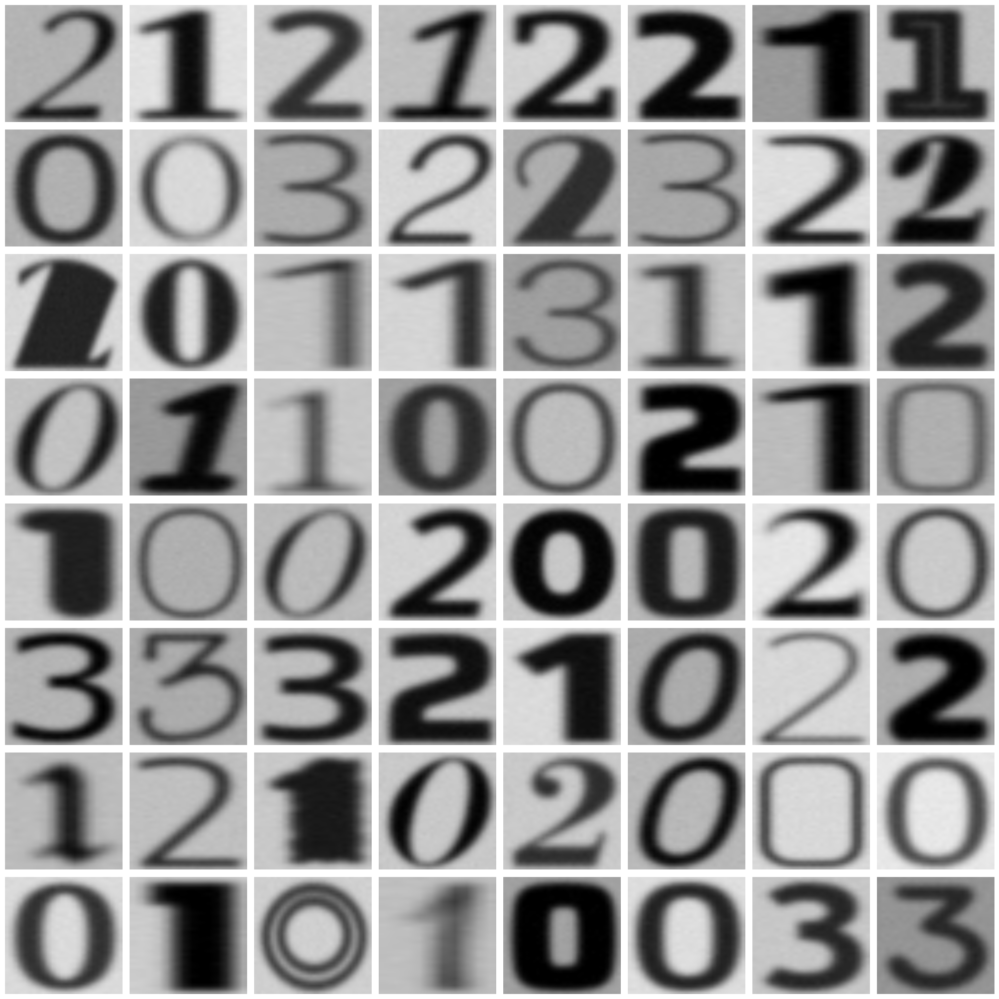

In [ ]:
show_images(data=train_ds)

In [ ]:
# All the backbones will be accessed through a name.
BACKBONE_NAMES = [
    'ResNet50V2',
    'ResNet101V2',
    'ResNet152V2',
    'Inception',
    'Xception',
    'MobileNet'
]

In [ ]:
# Load the backbones
BACKBONES = [
    tka.ResNet50V2(include_top=False, weights='imagenet', input_shape=(*IMAGE_SIZE, 3)),
    tka.ResNet101V2(include_top=False, weights='imagenet', input_shape=(*IMAGE_SIZE, 3)),
    tka.ResNet152V2(include_top=False, weights='imagenet', input_shape=(*IMAGE_SIZE, 3)),
    tka.InceptionV3(include_top=False, weights='imagenet', input_shape=(*IMAGE_SIZE, 3)),
    tka.Xception(include_top=False, weights='imagenet', input_shape=(*IMAGE_SIZE, 3)),
    tka.MobileNet(include_top=False, weights='imagenet', input_shape=(*IMAGE_SIZE, 3)),
]

for backbone in BACKBONES:
    backbone.trainable = False

83683744/83683744 [==============================] - 3s 0us/step


17225924/17225924 [==============================] - 1s 0us/step


In [ ]:
# store the Backbone histories.
BACKBONE_HISTORIES = []

# Iterate over the backbones
for name, backbone in zip(BACKBONE_NAMES, BACKBONES):

    # Show
    print(f'BACKBONE : {name.title()}\n')

    # Create a simple model architecture.
    dummy_model = keras.Sequential(layers=[
        layers.InputLayer(input_shape=(*IMAGE_SIZE, 3), name="InputLayer"),
        backbone,
        layers.GlobalAveragePooling2D(name="GAP"),
        layers.Dropout(0.2, name="DropoutLayer"),
        layers.Dense(len(class_names), activation='softmax', name="OutputLayer")
    ], name=name.strip().title())

    # Show the summary
    print('-'*100)
    print("Model Summary\n")
    dummy_model.summary()
    print("\n")
    print('-'*100)

    # Compile the model.
    dummy_model.compile(
        loss='sparse_categorical_crossentropy',
        optimizer='adam',
        metrics=['accuracy']
    )

    # Train the model
    print("\n")
    print('-'*100)
    print("Model Training\n")
    history = dummy_model.fit(train_ds, validation_data=test_ds, epochs=10)
    print("\n")
    print('-'*100)

    # Store the history
    BACKBONE_HISTORIES.append(
        pd.DataFrame(history.history)
    )

    # clear the output.
    cls()

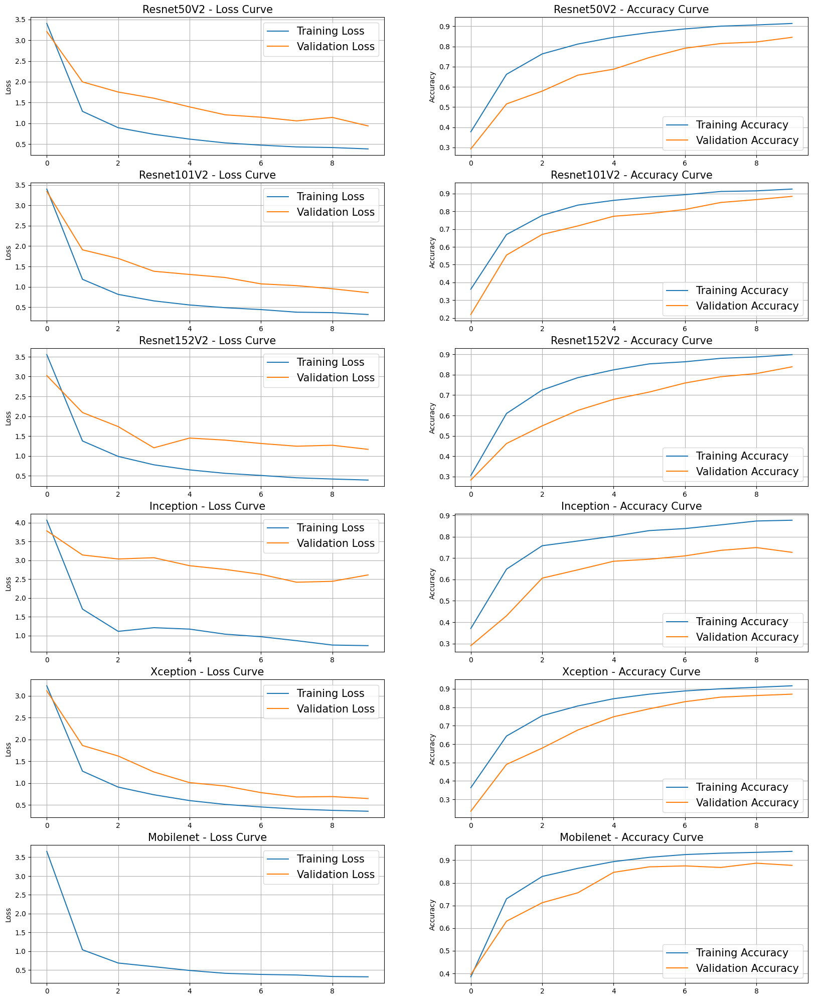

In [ ]:
# Plotting configurations
plt.figure(figsize=(20, 25))

# Iterate over the backbone histories.
index = 1
for name, history in zip(BACKBONE_NAMES, BACKBONE_HISTORIES):

    # subplot of the Backbone Learning curve.
    plt.subplot(6, 2, index)
    plt.title(name.strip().title() + " - Loss Curve", fontsize=15)
    plt.plot(history['loss'], label="Training Loss")
    plt.plot(history['val_loss'], label="Validation Loss")
    plt.ylabel("Loss")
    plt.legend(fontsize=15)
    plt.grid()

    plt.subplot(6, 2, index+1)
    plt.title(name.strip().title() + " - Accuracy Curve", fontsize=15)
    plt.plot(history['accuracy'], label="Training Accuracy")
    plt.plot(history['val_accuracy'], label="Validation Accuracy")
    plt.ylabel("Accuracy")
    plt.legend(fontsize=15)
    plt.grid()

    # update index
    index+=2

# show the final plot.
plt.savefig(f'{figure_dir}BackboneComparision-All.png')
plt.show()

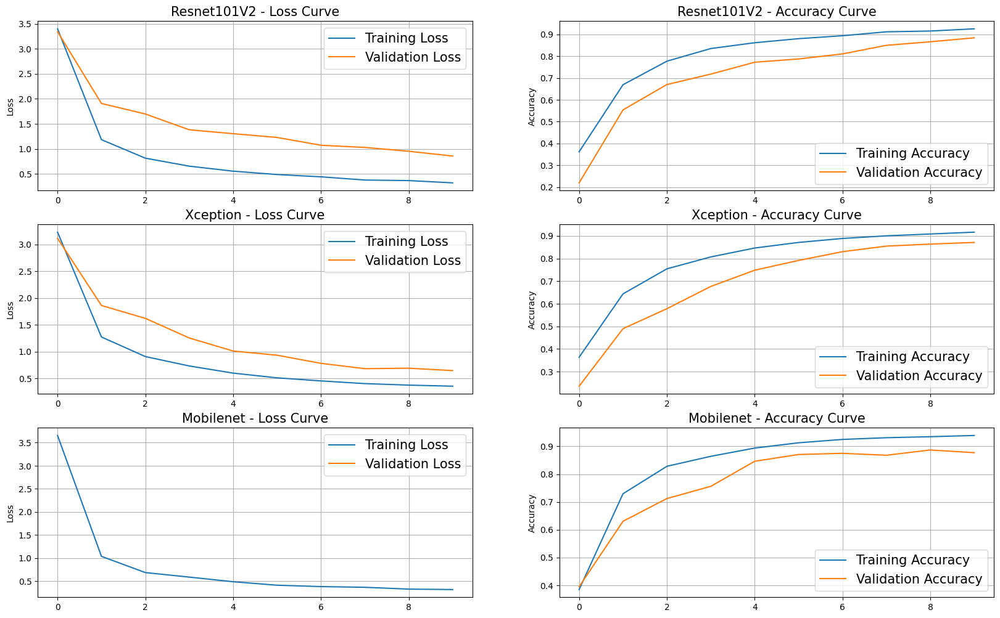

In [ ]:
# Name of the top 3 backbones.
TOP_3_BACKBONES = ['ResNet101V2', 'Xception', 'MobileNet']

# Plotting configurations
plt.figure(figsize=(20, 25))

# Iterate over the backbone histories.
index = 1
for name, history in zip(BACKBONE_NAMES, BACKBONE_HISTORIES):

    if name in TOP_3_BACKBONES:
        # subplot of the Backbone Learning curve.
        plt.subplot(6, 2, index)
        plt.title(name.strip().title() + " - Loss Curve", fontsize=15)
        plt.plot(history['loss'], label="Training Loss")
        plt.plot(history['val_loss'], label="Validation Loss")
        plt.ylabel("Loss")
        plt.legend(fontsize=15)
        plt.grid()

        plt.subplot(6, 2, index+1)
        plt.title(name.strip().title() + " - Accuracy Curve", fontsize=15)
        plt.plot(history['accuracy'], label="Training Accuracy")
        plt.plot(history['val_accuracy'], label="Validation Accuracy")
        plt.ylabel("Accuracy")
        plt.legend(fontsize=15)
        plt.grid()

        # update index
        index+=2

# show the final plot.
plt.savefig(f'{figure_dir}BackboneComparision-Top3.png')
plt.show()

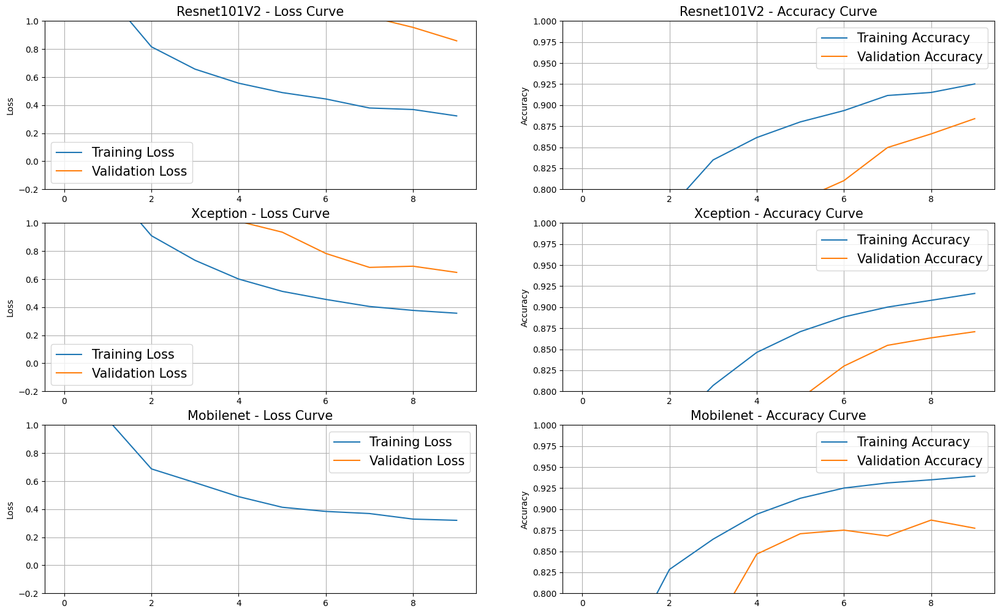

In [ ]:
# Name of the top 3 backbones.
TOP_3_BACKBONES = ['ResNet101V2', 'Xception', 'MobileNet']

# Plotting configurations
plt.figure(figsize=(20, 25))

# Iterate over the backbone histories.
index = 1
for name, history in zip(BACKBONE_NAMES, BACKBONE_HISTORIES):

    if name in TOP_3_BACKBONES:
        # subplot of the Backbone Learning curve.
        plt.subplot(6, 2, index)
        plt.title(name.strip().title() + " - Loss Curve", fontsize=15)
        plt.plot(history['loss'], label="Training Loss")
        plt.plot(history['val_loss'], label="Validation Loss")
        plt.ylabel("Loss")
        plt.legend(fontsize=15)
        plt.grid()
        plt.ylim(bottom=-0.2, top=1)

        plt.subplot(6, 2, index+1)
        plt.title(name.strip().title() + " - Accuracy Curve", fontsize=15)
        plt.plot(history['accuracy'], label="Training Accuracy")
        plt.plot(history['val_accuracy'], label="Validation Accuracy")
        plt.ylabel("Accuracy")
        plt.legend(fontsize=15)
        plt.grid()
        plt.ylim(bottom=0.8, top=1)

        # update index
        index+=2

# show the final plot.
plt.savefig(f'{figure_dir}BackboneComparision-Top3-CloseLook.png')
plt.show()

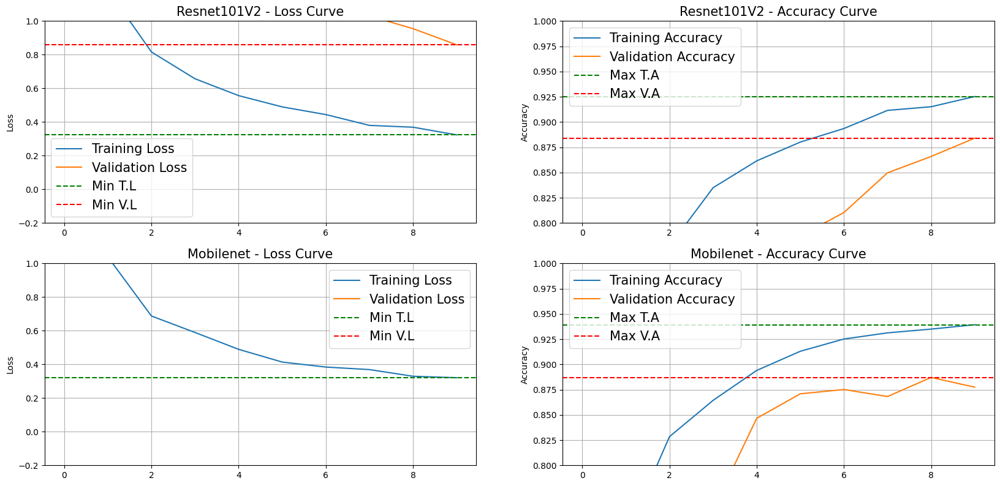

In [ ]:
# Name of the top 3 backbones.
TOP_3_BACKBONES = ['ResNet101V2', 'MobileNet']

# Plotting configurations
plt.figure(figsize=(20, 30))

# Iterate over the backbone histories.
index = 1
for name, history in zip(BACKBONE_NAMES, BACKBONE_HISTORIES):

    if name in TOP_3_BACKBONES:
        # subplot of the Backbone Learning curve.
        plt.subplot(6, 2, index)
        plt.title(name.strip().title() + " - Loss Curve", fontsize=15)
        plt.plot(history['loss'], label="Training Loss")
        plt.plot(history['val_loss'], label="Validation Loss")
        plt.axhline(y=min(history['loss']), label="Min T.L", color='g', linestyle='--')
        plt.axhline(y=min(history['val_loss']), label="Min V.L", color='r', linestyle='--')
        plt.ylabel("Loss")
        plt.legend(fontsize=15)
        plt.grid()
        plt.ylim(bottom=-0.2, top=1)

        plt.subplot(6, 2, index+1)
        plt.title(name.strip().title() + " - Accuracy Curve", fontsize=15)
        plt.plot(history['accuracy'], label="Training Accuracy")
        plt.plot(history['val_accuracy'], label="Validation Accuracy")
        plt.axhline(y=max(history['accuracy']), label="Max T.A", color='g', linestyle='--')
        plt.axhline(y=max(history['val_accuracy']), label="Max V.A", color='r', linestyle='--')
        plt.ylabel("Accuracy")
        plt.legend(fontsize=15)
        plt.grid()
        plt.ylim(bottom=0.8, top=1)

        # update index
        index+=2

# show the final plot.
plt.savefig(f'{figure_dir}BackboneComparision-Top2-CloseLook.png')
plt.show()

In [ ]:
# Using the best validation accuracy as baseline accuracy.
RESNET_BASELINE_ACC = max(BACKBONE_HISTORIES[BACKBONE_NAMES.index('ResNet101V2')]['val_accuracy'])
MOBILENET_BASELINE_ACC = max(BACKBONE_HISTORIES[BACKBONE_NAMES.index('MobileNet')]['val_accuracy'])

# Similarly, using the best validation loss as the baseline loss.
RESNET_BASELINE_LOSS = min(BACKBONE_HISTORIES[BACKBONE_NAMES.index('ResNet101V2')]['val_loss'])
MOBILENET_BASELINE_LOSS = min(BACKBONE_HISTORIES[BACKBONE_NAMES.index('MobileNet')]['val_loss'])

print('--'*50)
print(" "*25 + f"ResNet Best Loss : {np.round(RESNET_BASELINE_LOSS, decimals=4)}; Best Accuracy : {np.round(RESNET_BASELINE_ACC, decimals=3)*100}%")
print('--'*50)
print(" "*25 + f"MobileNet Best Loss : {np.round(MOBILENET_BASELINE_LOSS, decimals=4)}; Best Accuracy : {np.round(MOBILENET_BASELINE_ACC, decimals=3)*100}%")
print('--'*50)

----------------------------------------------------------------------------------------------------
                         ResNet Best Loss : 0.8586; Best Accuracy : 88.4%
----------------------------------------------------------------------------------------------------
                         MobileNet Best Loss : 2.5253; Best Accuracy : 88.7%
----------------------------------------------------------------------------------------------------


In [ ]:
def build_model(hp):

    # Backbone
    backbone = tka.ResNet101V2(include_top=False, weights='imagenet', input_shape=(*IMAGE_SIZE, 3))
    backbone.trainable = False

    # Base Model
    model = keras.Sequential(layers=[
        layers.InputLayer(input_shape=(*IMAGE_SIZE, 3), name="InputLayer"),
        backbone,                                                            # ResNet50V2
        layers.GlobalAveragePooling2D(name="GAP"),
    ], name='ResNet101V2')

    # Params to tweak
    for i in range(hp.Choice('n_layers', [1,2,4])):
        model.add(layers.Dense(hp.Choice('n_units', [64, 256, 512])))
    model.add(layers.Dropout(hp.Choice('rate', [0.2,0.4])))

    # Output layer
    model.add(layers.Dense(len(class_names), activation='softmax'))

    # Compile the model.
    model.compile(
        loss='sparse_categorical_crossentropy',
        optimizer=keras.optimizers.Adam(hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])),
        metrics=['accuracy']
    )

    return model

In [ ]:
# Initialize tuner
tuner = kt.RandomSearch(hypermodel=build_model, objective='val_loss', project_name='ResNet50V2-OCR-3')

# Start hyperparameter search.
tuner.search(
    train_ds,
    validation_data=valid_ds,
    epochs = 5
)

Trial 10 Complete [00h 01m 47s]
val_loss: 0.4075392186641693

Best val_loss So Far: 0.40560784935951233
Total elapsed time: 00h 18m 02s


In [ ]:
# Get the best model and build it
best_model = tuner.get_best_models()[0]
best_model.build(input_shape=(*IMAGE_SIZE, 3))

In [ ]:
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

In [ ]:
print(best_hps.get('n_layers'))

1


In [ ]:
print(best_hps.get('n_units'))

256


In [ ]:
print(best_hps.get('rate'))

0.4


In [ ]:
print(best_hps.get('learning_rate'))

0.0001


In [ ]:
# Best Model Summary
best_model.summary()

Model: "ResNet101V2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101v2 (Functional)    (None, 4, 4, 2048)        42626560  
                                                                 
 GAP (GlobalAveragePooling2  (None, 2048)              0         
 D)                                                              
                                                                 
 dense (Dense)               (None, 256)               524544    
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 36)                9252      
                                                                 
Total params: 43160356 (164.64 MB)
Trainable params: 533796 (2.04 MB)
Non-trainable params: 42626560 (162.61 MB)
________

In [ ]:
# Training the model
best_model_history = best_model.fit(
    train_ds,
    validation_data=valid_ds,
    epochs=100,
    callbacks = [
        callbacks.EarlyStopping(patience=3, restore_best_weights=True),
        callbacks.ModelCheckpoint(f'{model_dir}StandardOCR-ResNet101V2_V1_full.h5', save_best_only=True),
        callbacks.TensorBoard(f'{tensorboard_log_dir}{datetime.datetime.now().strftime("%Y%m%d-%H%M%S")}', histogram_freq=1)
    ]
)

Epoch 1/100
323/323 [==============================] - ETA: 0s - loss: 0.2204 - accuracy: 0.9363

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


323/323 [==============================] - 44s 135ms/step - loss: 0.2204 - accuracy: 0.9363 - val_loss: 0.1540 - val_accuracy: 0.9599
Epoch 2/100
323/323 [==============================] - 40s 125ms/step - loss: 0.2508 - accuracy: 0.9276 - val_loss: 0.1667 - val_accuracy: 0.9460
Epoch 3/100
323/323 [==============================] - 41s 126ms/step - loss: 0.2202 - accuracy: 0.9324 - val_loss: 0.1632 - val_accuracy: 0.9537
Epoch 4/100
323/323 [==============================] - 42s 131ms/step - loss: 0.2079 - accuracy: 0.9341 - val_loss: 0.0688 - val_accuracy: 0.9769
Epoch 5/100
323/323 [==============================] - 41s 125ms/step - loss: 0.1964 - accuracy: 0.9360 - val_loss: 0.0832 - val_accuracy: 0.9691
Epoch 6/100
323/323 [==============================] - 40s 125ms/step - loss: 0.1820 - accuracy: 0.9419 - val_loss: 0.0873 - val_accuracy: 0.9676
Epoch 7/100
323/323 [==============================] - 42s 131ms/step - loss: 0.1662 - accuracy: 0.9433 - val_loss: 0.0599 - val_accurac

In [ ]:
# Valid Data
best_model.evaluate(valid_ds)

11/11 [==============================] - 1s 97ms/step - loss: 0.0532 - accuracy: 0.9769


[0.05319913104176521, 0.9768518805503845]

In [ ]:
# Test data
best_model.evaluate(test_ds)

41/41 [==============================] - 5s 103ms/step - loss: 0.1819 - accuracy: 0.9217


[0.18185222148895264, 0.9217424988746643]

In [ ]:
best_model.save(f'{model_dir}StandardOCR-ResNet101V2_V1.h5')

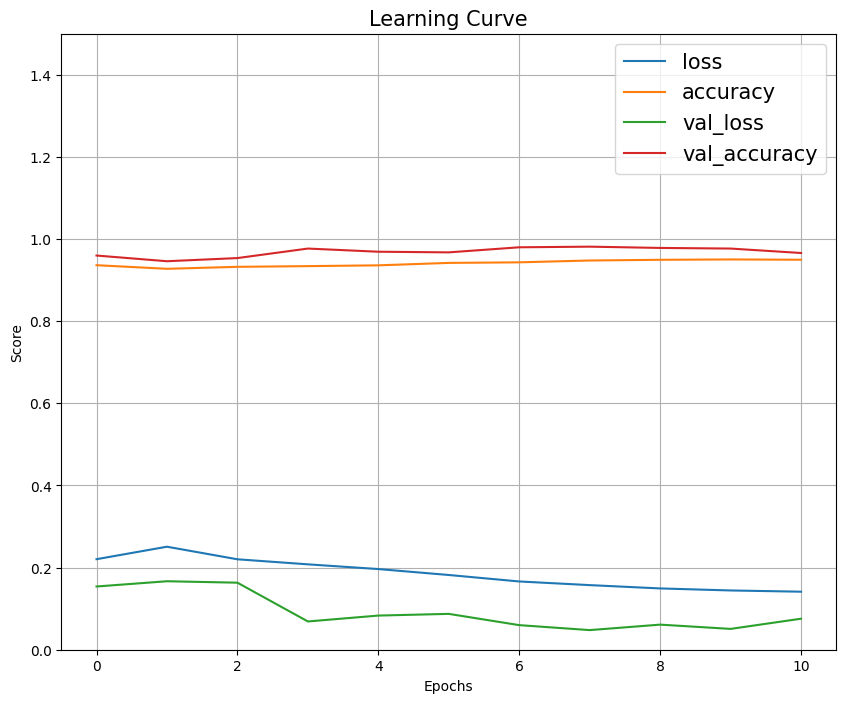

In [ ]:
pd.DataFrame(best_model_history.history).plot(figsize=(10,8))
plt.title("Learning Curve", fontsize=15)
plt.legend(fontsize=15)
plt.ylim([0,1.5])
plt.ylabel('Score')
plt.xlabel('Epochs')
plt.grid()
plt.show()

In [ ]:
# Backbone
backbone = tka.ResNet101V2(include_top=False, weights='imagenet', input_shape=(*IMAGE_SIZE, 3))
backbone.trainable = True

# Base Model
model = keras.Sequential(layers=[
    layers.InputLayer(input_shape=(*IMAGE_SIZE, 3), name="InputLayer"),
    backbone,                                                            # ResNet50V2
    layers.GlobalAveragePooling2D(name="GAP"),
    layers.Dense(256),
    layers.Dropout(0.4),
    layers.Dense(len(class_names), activation='softmax')
])

# Compile the model.
model.compile(
    loss='sparse_categorical_crossentropy',
    optimizer=keras.optimizers.Adam(learning_rate= 1e-4),
    metrics=['accuracy']
)

# History
history = model.fit(
    train_ds,
    validation_data=valid_ds,
    epochs=100,
    callbacks = [
        callbacks.EarlyStopping(patience=3, restore_best_weights=True),
        callbacks.ModelCheckpoint(f'{model_dir}StandardOCR-ResNet101V2_V2_Full.h5', save_best_only=True),
        callbacks.TensorBoard(f'{tensorboard_log_dir}{datetime.datetime.now().strftime("%Y%m%d-%H%M%S")}', histogram_freq=1)
    ]
)

Epoch 1/100
323/323 [==============================] - 166s 382ms/step - loss: 0.9379 - accuracy: 0.7988 - val_loss: 4.6523 - val_accuracy: 0.4383
Epoch 2/100
323/323 [==============================] - 123s 379ms/step - loss: 0.2887 - accuracy: 0.9379 - val_loss: 1.6857 - val_accuracy: 0.5926
Epoch 3/100
323/323 [==============================] - 124s 384ms/step - loss: 0.1104 - accuracy: 0.9755 - val_loss: 0.9985 - val_accuracy: 0.8040
Epoch 4/100
323/323 [==============================] - 124s 382ms/step - loss: 0.0606 - accuracy: 0.9869 - val_loss: 0.6933 - val_accuracy: 0.8812
Epoch 5/100
323/323 [==============================] - 118s 365ms/step - loss: 0.0384 - accuracy: 0.9905 - val_loss: 0.7491 - val_accuracy: 0.8935
Epoch 6/100
323/323 [==============================] - 123s 382ms/step - loss: 0.0297 - accuracy: 0.9925 - val_loss: 0.3888 - val_accuracy: 0.8889
Epoch 7/100
323/323 [==============================] - 123s 381ms/step - loss: 0.0210 - accuracy: 0.9950 - val_loss: 0

In [ ]:
# Valid Data
model.evaluate(valid_ds)

11/11 [==============================] - 1s 97ms/step - loss: 0.2325 - accuracy: 0.9460


[0.23246465623378754, 0.9459876418113708]

In [ ]:
# Test data
model.evaluate(test_ds)

41/41 [==============================] - 4s 102ms/step - loss: 0.7428 - accuracy: 0.8500


[0.7427821755409241, 0.8500385284423828]

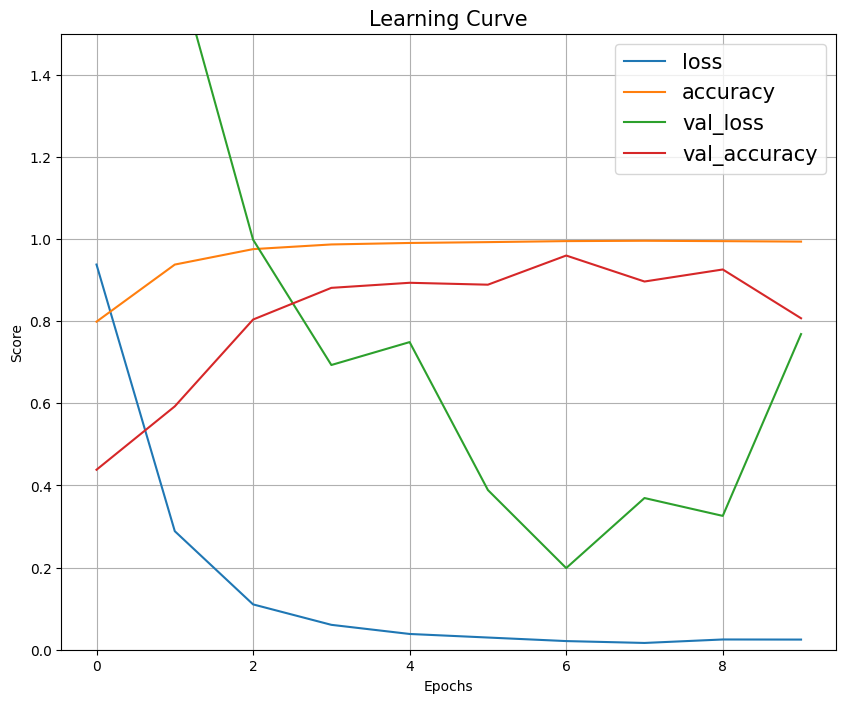

In [ ]:
pd.DataFrame(history.history).plot(figsize=(10,8))
plt.title("Learning Curve", fontsize=15)
plt.legend(fontsize=15)
plt.ylim([0,1.5])
plt.ylabel('Score')
plt.xlabel('Epochs')
plt.grid()
plt.show()

In [ ]:
# Evaluation on Test Set
model.evaluate(test_ds)

41/41 [==============================] - 4s 104ms/step - loss: 0.7379 - accuracy: 0.8458


[0.737890362739563, 0.8457980155944824]

In [77]:
%tensorboard --logdir /content/gdrive/MyDrive/OWR/log/OCR_Model2/ --port=6001

Output hidden; open in https://colab.research.google.com to view.

## Model Predictions


1/1 [==============================] - 0s 26ms/step


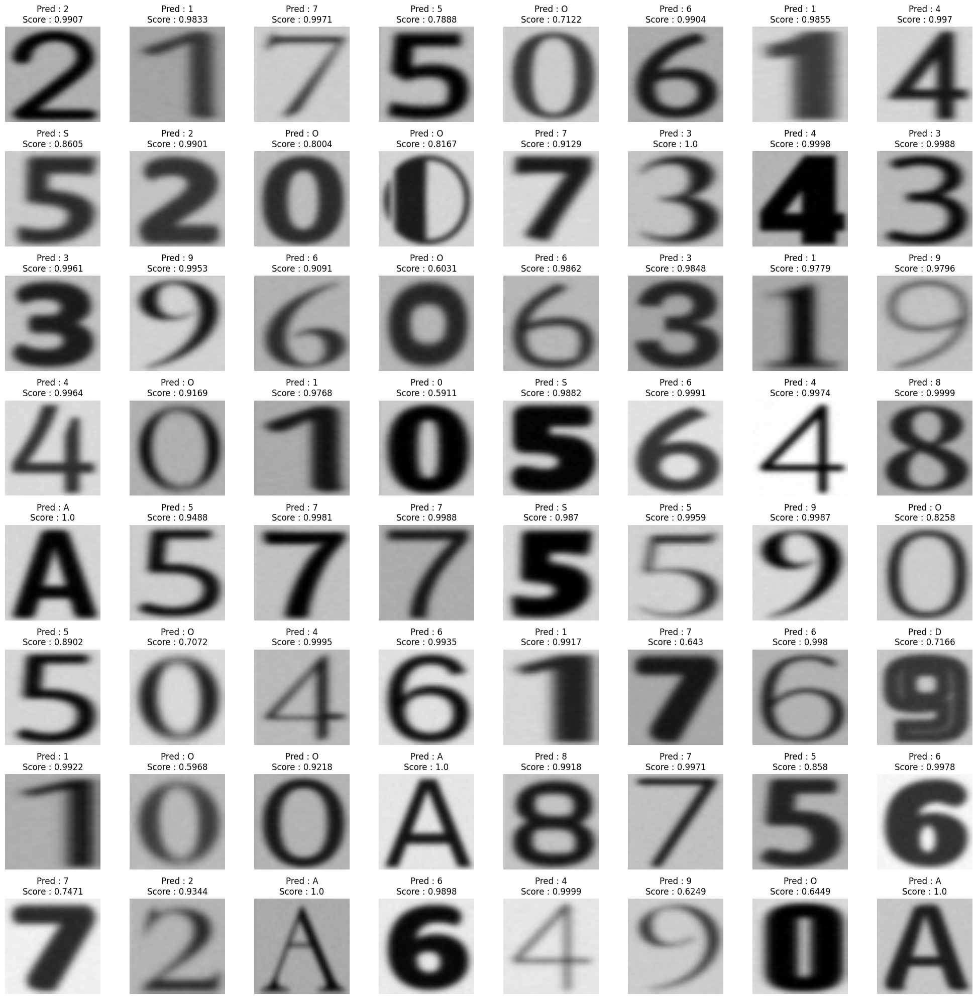

In [80]:
show_images(data=test_ds, model=best_model)

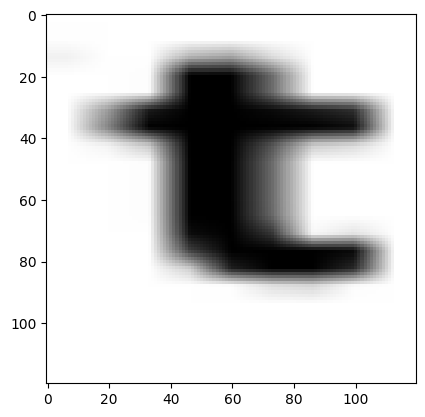

In [123]:
real_image = load_image('/content/gdrive/MyDrive/OWR/data/tmpCharacterSegment2/character_11.png')
plt.imshow(tf.squeeze(real_image))

In [124]:
#pred = best_model.predict(real_image)[0]
#pred = best_model.predict(tf.squeeze(real_image))


image = tf.expand_dims(real_image, axis=0)
pred = model.predict(image)[0]
max_index = tf.argmax(pred)
score = pred[max_index]
pred_label = class_names[max_index]
print(pred_label)

1/1 [==============================] - 0s 28ms/step
X


In [95]:
pred_label

'T'

In [88]:
pred

array([2.1637072e-07, 1.1937759e-07, 2.3410909e-08, 1.3601160e-08,
       2.9221164e-08, 3.9476160e-09, 1.6557687e-08, 2.7455312e-07,
       8.4643387e-10, 1.1845853e-07, 1.1460434e-07, 1.3624805e-06,
       2.1786143e-08, 2.3128657e-06, 8.5291957e-10, 2.6803193e-06,
       5.3915357e-12, 3.2294534e-07, 3.9703978e-09, 7.2582291e-09,
       1.4629697e-09, 4.7680664e-06, 1.8023286e-08, 4.5069049e-07,
       2.9767580e-07, 9.9997985e-01, 2.4781057e-11, 9.4609911e-09,
       7.8240729e-09, 2.4998968e-07, 4.9228271e-10, 1.2954713e-06,
       4.6181188e-09, 1.0375410e-06, 4.3341424e-06, 1.5481163e-08],
      dtype=float32)

In [89]:
max_index

<tf.Tensor: shape=(), dtype=int64, numpy=25>

In [90]:
score

0.99997985

In [91]:
pred_label

'P'